In [1]:
import os
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import h5py

In [2]:
import scvi
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.6


In [3]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

In [4]:
adatas = [x for x in os.listdir('/mnt/c/Users/ethan/OneDrive/桌面/Heter_Neu/SC1186/rawdata/') if x.endswith('.h5')]

In [5]:
adatas

['2054_00_raw_.h5',
 '2060_41_raw_.h5',
 '2070_00_raw_.h5',
 '2072_00_raw_.h5',
 '2074_00_raw_.h5',
 '2075_00_raw_.h5',
 '2094_01_raw_.h5',
 'S14_00_raw_.h5',
 'S15_00_raw_.h5',
 'S16_00_raw_.h5',
 'S17_00_raw_.h5']

In [6]:
def load_it(adata):
    samp = adata.split('_')[0]
    days = adata.split('_')[1]
    adata = sc.read_10x_h5('/mnt/c/Users/ethan/OneDrive/桌面/Heter_Neu/SC1186/rawdata/' + adata)
    adata.var_names_make_unique()
    adata.obs['Patient'] = samp
    adata.obs['Days'] = days
    adata.obs['Sample'] = adata.obs['Patient'] + '_' + adata.obs['Days']
    adata.obs.index = adata.obs.index + '-' + samp + '_' + days
    return adata

In [7]:
adatas = [load_it(ad) for ad in adatas]

In [8]:
adatas

[AnnData object with n_obs × n_vars = 98896 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 64501 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 90838 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 116580 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 141204 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 52652 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_obs × n_vars = 102976 × 37143
     obs: 'Patient', 'Days', 'Sample'
     var: 'gene_ids', 'feature_types', 'genome',
 AnnData object with n_o

In [9]:
adata_combined = sc.concat(adatas, join='outer')

In [10]:
adata_combined.X.shape

(1129253, 37143)

In [11]:
sc.tl.pca(adata_combined)

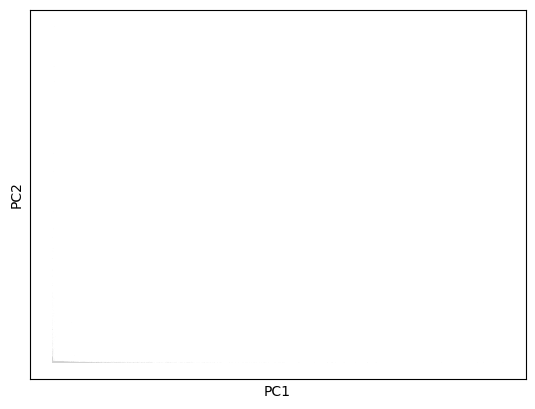

In [12]:
sc.pl.pca(adata_combined)

In [18]:
sc.pp.neighbors(adata_combined)
sc.tl.umap(adata_combined)


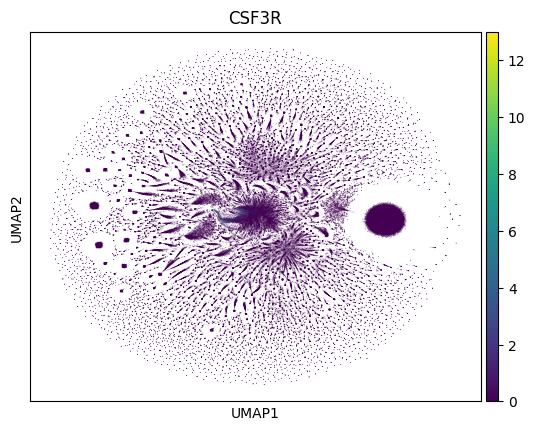

In [19]:
sc.pl.umap(adata_combined, color=['CSF3R'])

In [11]:
sc.pp.filter_genes(adata_combined, min_counts=50)

In [12]:
sc.pp.filter_cells(adata_combined, min_counts=3)

In [13]:
sc.pp.filter_cells(adata_combined, min_genes=15) 

In [14]:
adata_combined.layers["counts"] = adata_combined.X.copy()

In [15]:
sc.pp.normalize_total(adata_combined)
sc.pp.log1p(adata_combined)

In [16]:
adata_combined.raw = adata_combined

In [17]:
scvi.model.SCVI.setup_anndata(adata_combined, layer="counts")

In [18]:
model = scvi.model.SCVI(adata_combined, n_layers=2, n_latent=30, gene_likelihood="nb")

In [19]:
model.train()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 160/160: 100%|█████| 160/160 [09:07<00:00,  3.47s/it, v_num=1, train_loss_step=468, train_loss_epoch=426]

`Trainer.fit` stopped: `max_epochs=160` reached.


Epoch 160/160: 100%|█████| 160/160 [09:07<00:00,  3.42s/it, v_num=1, train_loss_step=468, train_loss_epoch=426]


In [20]:
SCVI_LATENT_KEY = "X_scVI"
adata_combined.obsm[SCVI_LATENT_KEY] = model.get_latent_representation()

In [21]:
sc.pp.neighbors(adata_combined, use_rep=SCVI_LATENT_KEY)
sc.tl.leiden(adata_combined)

In [ ]:
#pip install pymde

In [23]:
SCVI_MDE_KEY = "X_scVI_MDE"
adata_combined.obsm[SCVI_MDE_KEY] = scvi.model.utils.mde(adata_combined.obsm[SCVI_LATENT_KEY])

INFO     Using cuda:0 for `pymde.preserve_neighbors`.                                                              


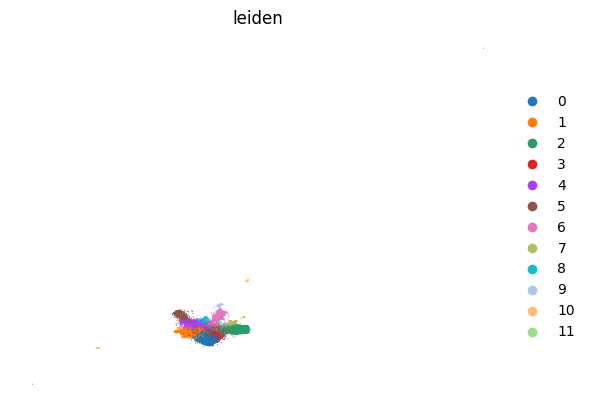

In [24]:
sc.pl.embedding(
    adata_combined,
    basis=SCVI_MDE_KEY,
    color="leiden",
    frameon=False,
    ncols=1,
)

In [25]:
import torch
import tempfile
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

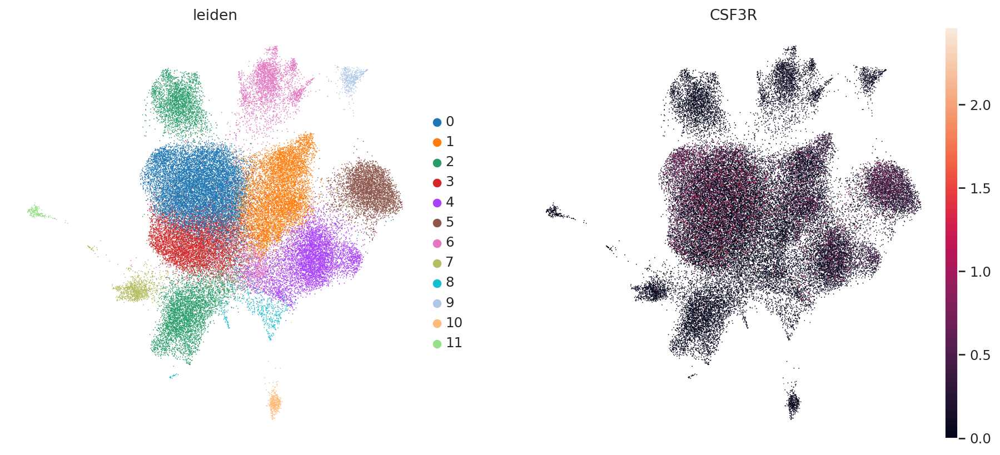

In [26]:
sc.tl.umap(adata_combined, min_dist=0.5, spread=2.0)
sc.pl.umap(adata_combined, color=['leiden','CSF3R'])


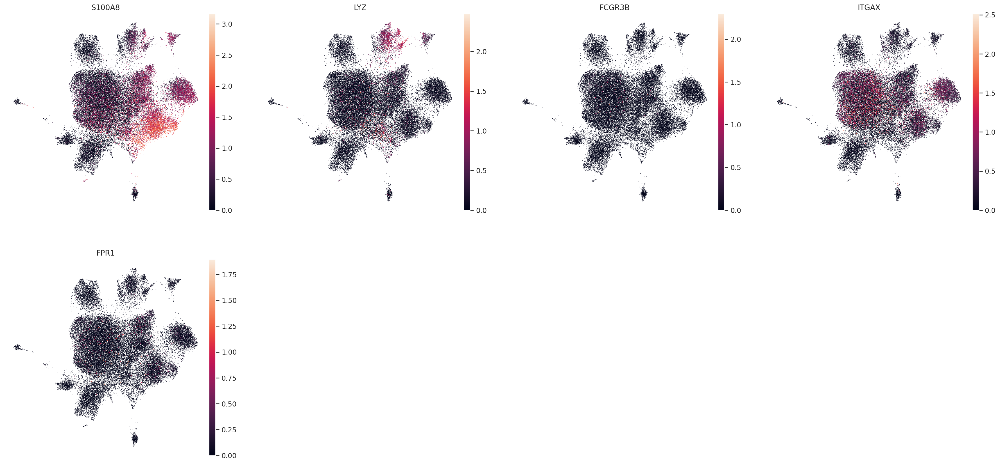

In [33]:
sc.pl.umap(adata_combined, color=['S100A8','LYZ','FCGR3B','ITGAX','FPR1'])

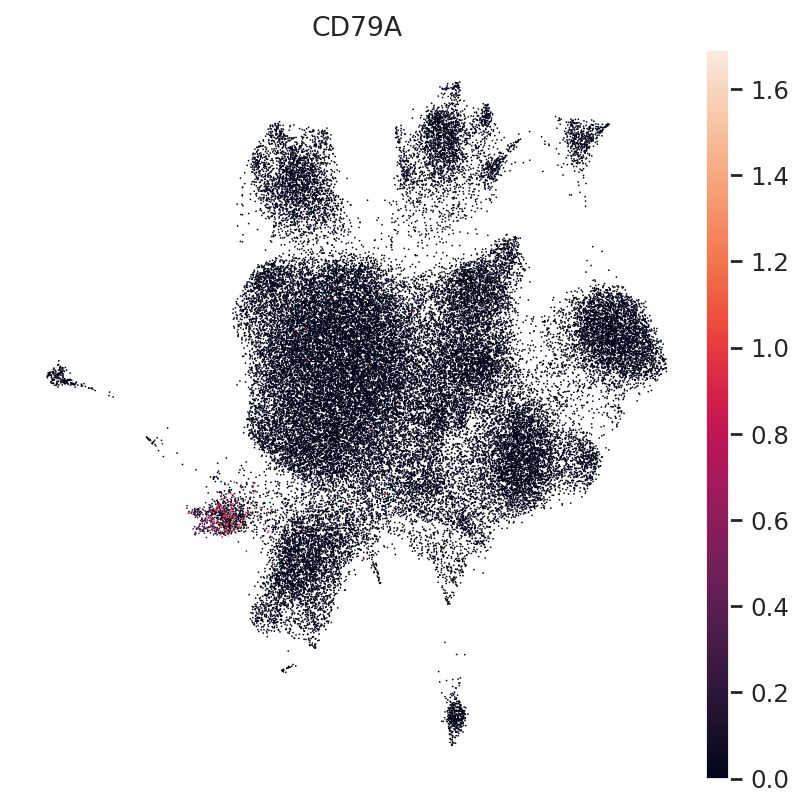

In [38]:
sc.pl.umap(adata_combined, color=['CD79A'])

In [35]:
print("CD19" in adata_combined.var_names)
print("CD79A" in adata_combined.var_names)

False
True


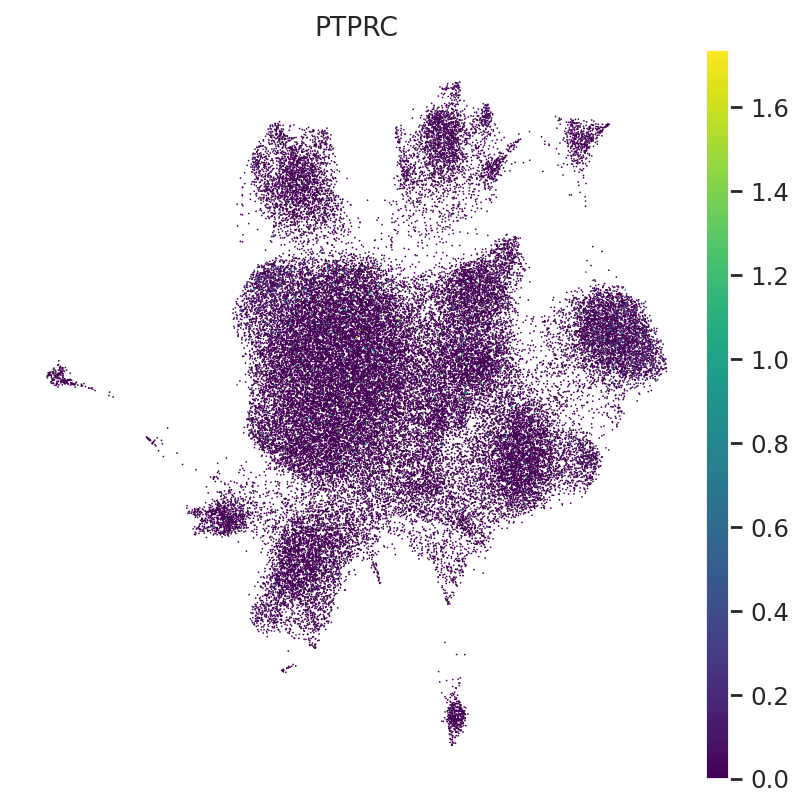

In [43]:
#CD45
sc.pl.umap(adata_combined, color=['PTPRC'], cmap='viridis')

In [ ]:
sc.pl.umap(adata_combined, color=['ITGAM','CCR2','CD14','FCGR3A','LYZ','CSF1R'], cmap='viridis')

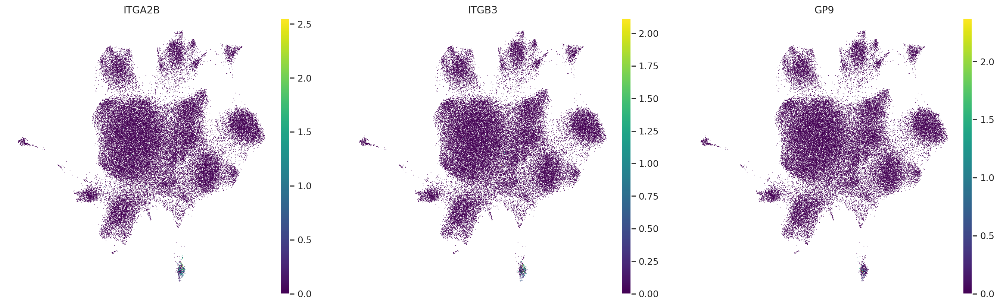

In [51]:
#platelets
sc.pl.umap(adata_combined, color=['ITGA2B','ITGB3','GP9'], cmap='viridis')

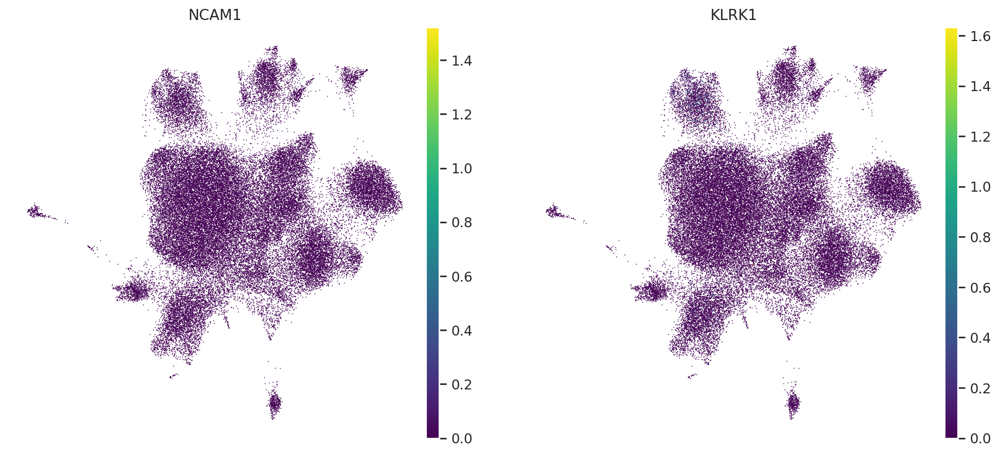

In [54]:
#NK cells
sc.pl.umap(adata_combined, color=['NCAM1','KLRK1'], cmap='viridis')

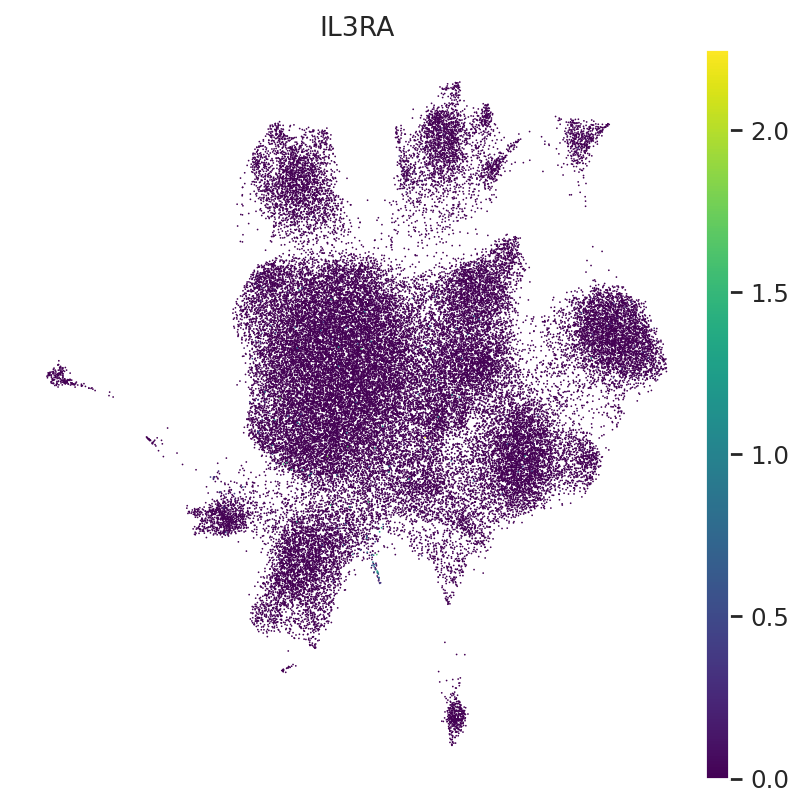

In [61]:
#basophils
sc.pl.umap(adata_combined, color=['IL3RA'], cmap='viridis')

In [ ]:
sc.pl.umap(adata_combined, color=['FCER1A','CD86'], cmap='viridis')

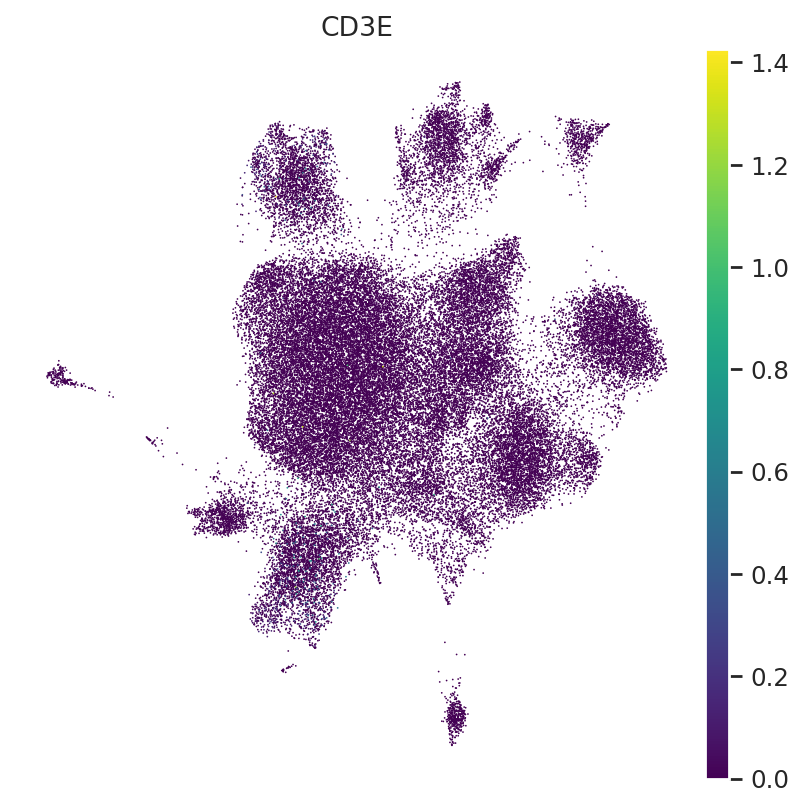

In [72]:
sc.pl.umap(adata_combined, color=['CD3E'], cmap='viridis')

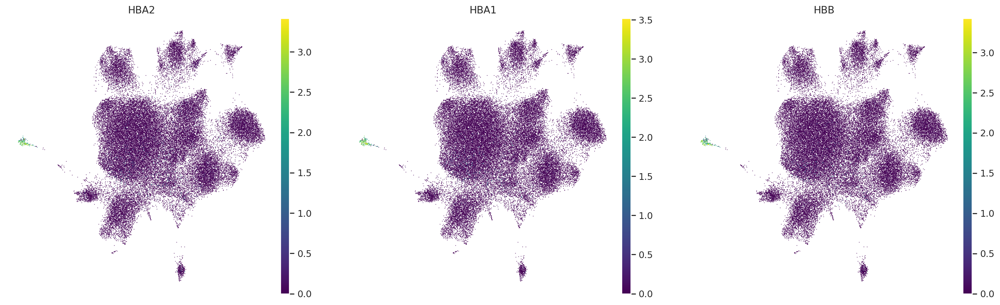

In [77]:
#erythrocytes
sc.pl.umap(adata_combined, color=['HBA2','HBA1','HBB'], cmap='viridis')

In [66]:
sc.pp.highly_variable_genes(adata_combined, n_top_genes=2000)

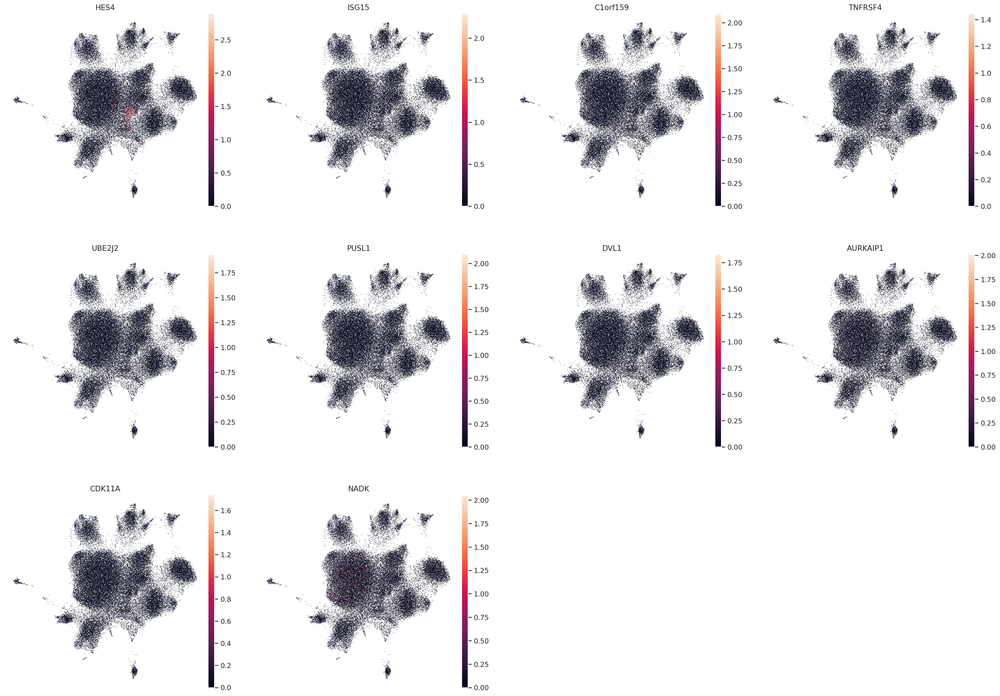

In [67]:
hvg_genes = adata_combined.var[adata_combined.var['highly_variable']].index.tolist()

sc.pl.umap(adata_combined, color=hvg_genes[:10])


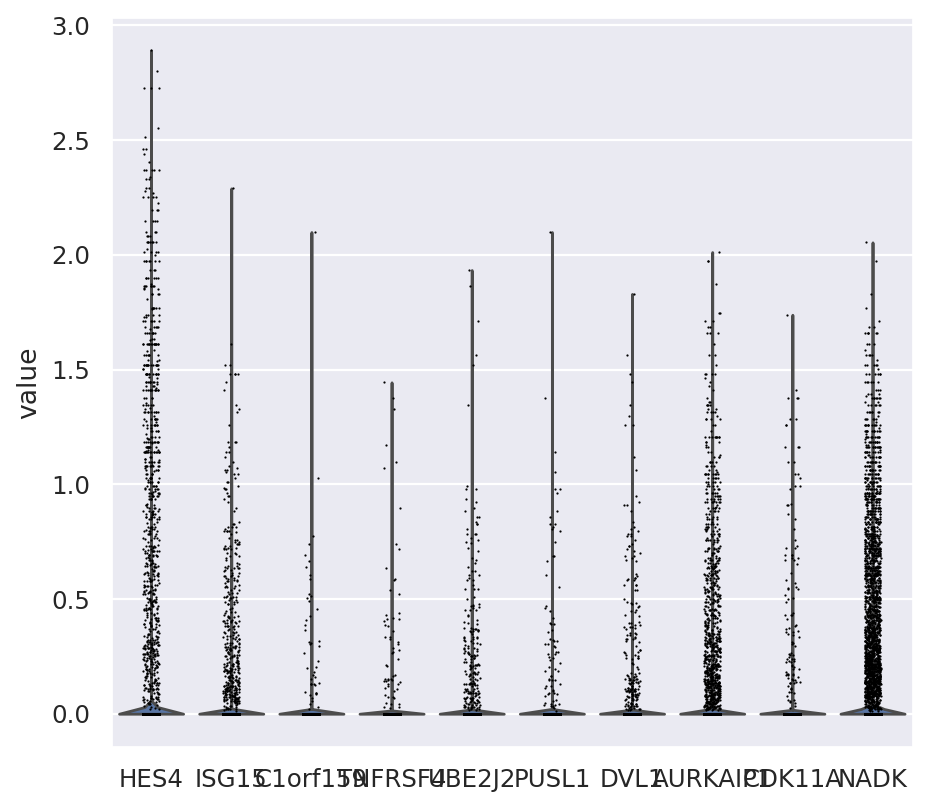

In [31]:
sc.pl.violin(adata_combined, keys=hvg_genes[:10])

In [69]:
cluster_2_cells = adata_combined[adata_combined.obs['leiden'] == '2']

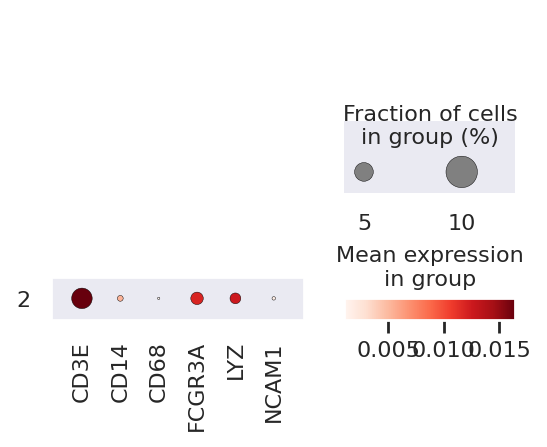

In [71]:
sc.pl.dotplot(cluster_2_cells, ['CD3E', 'CD14', 'CD68', 'FCGR3A', 'LYZ', 'NCAM1'], groupby='leiden')

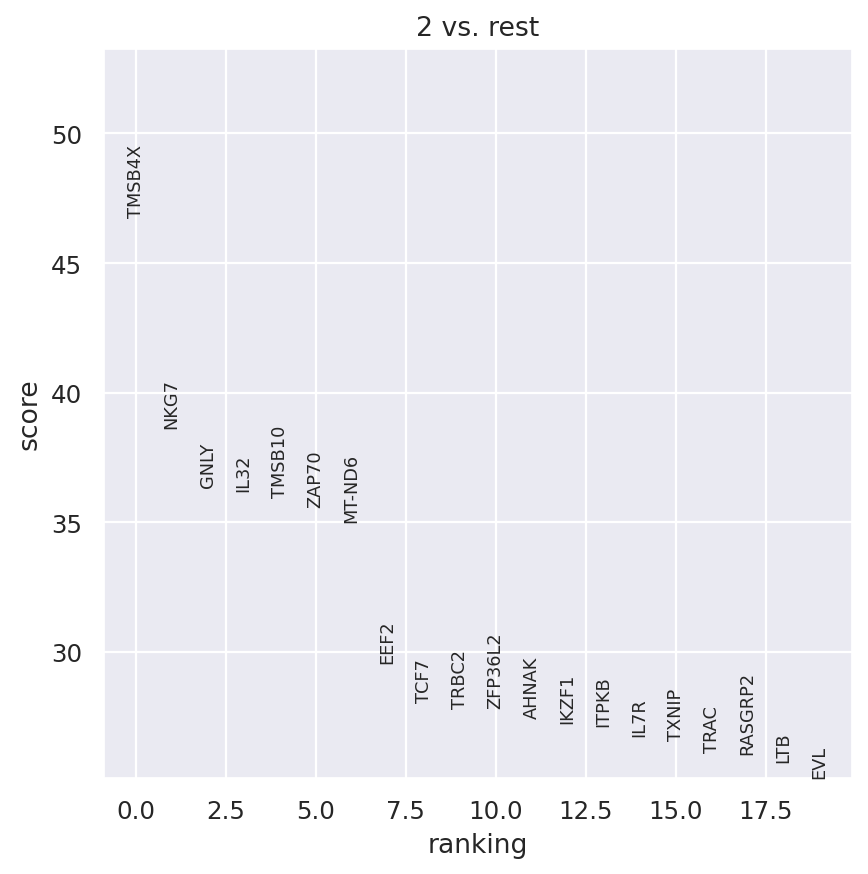

In [73]:
sc.tl.rank_genes_groups(adata_combined, groupby='leiden', groups=['2'], reference='rest')
sc.pl.rank_genes_groups(adata_combined, n_genes=20, sharey=False)


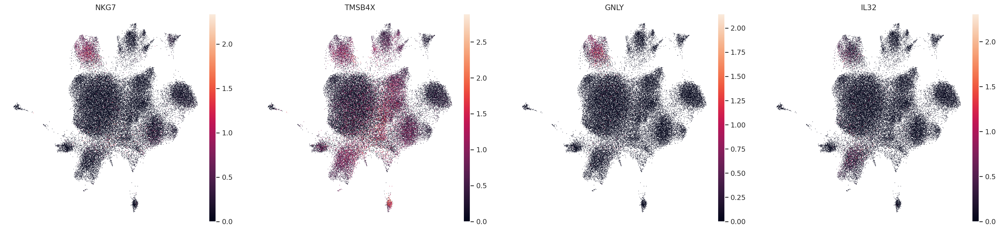

In [74]:
sc.pl.umap(adata_combined, color=['NKG7', 'TMSB4X', 'GNLY','IL32'])

In [75]:
cluster_11_cells = adata_combined[adata_combined.obs['leiden'] == '11']

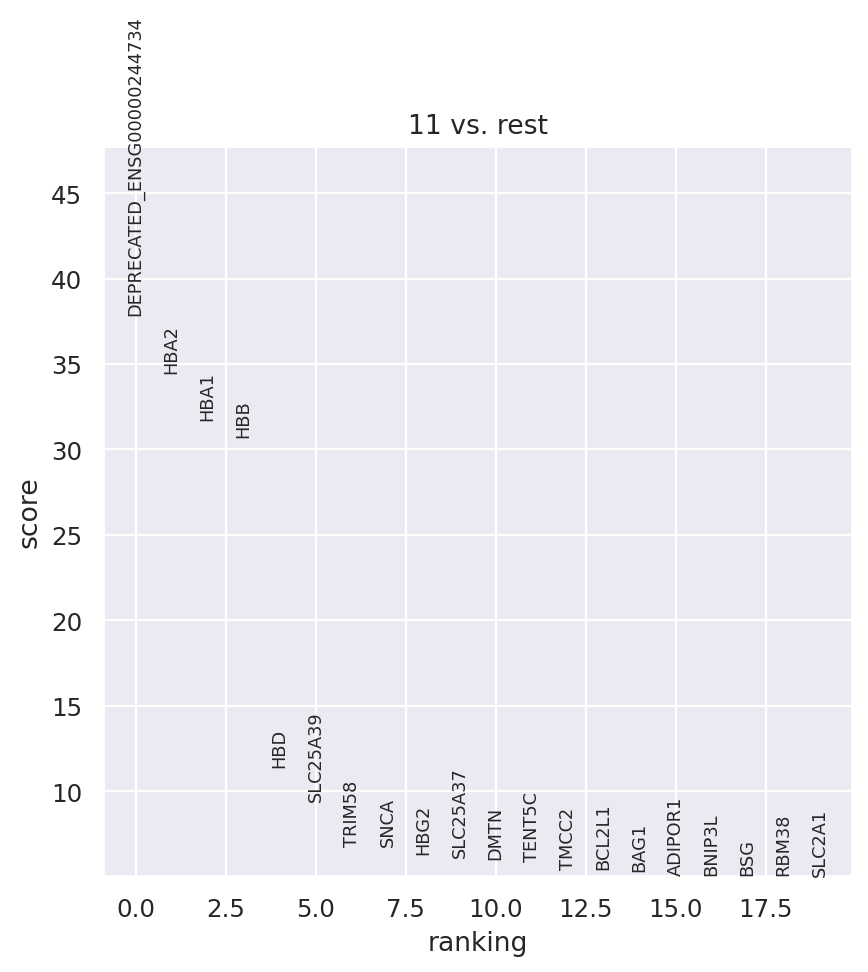

In [76]:
sc.tl.rank_genes_groups(adata_combined, groupby='leiden', groups=['11'], reference='rest')
sc.pl.rank_genes_groups(adata_combined, n_genes=20, sharey=False)


In [78]:
cluster_10_cells = adata_combined[adata_combined.obs['leiden'] == '10']

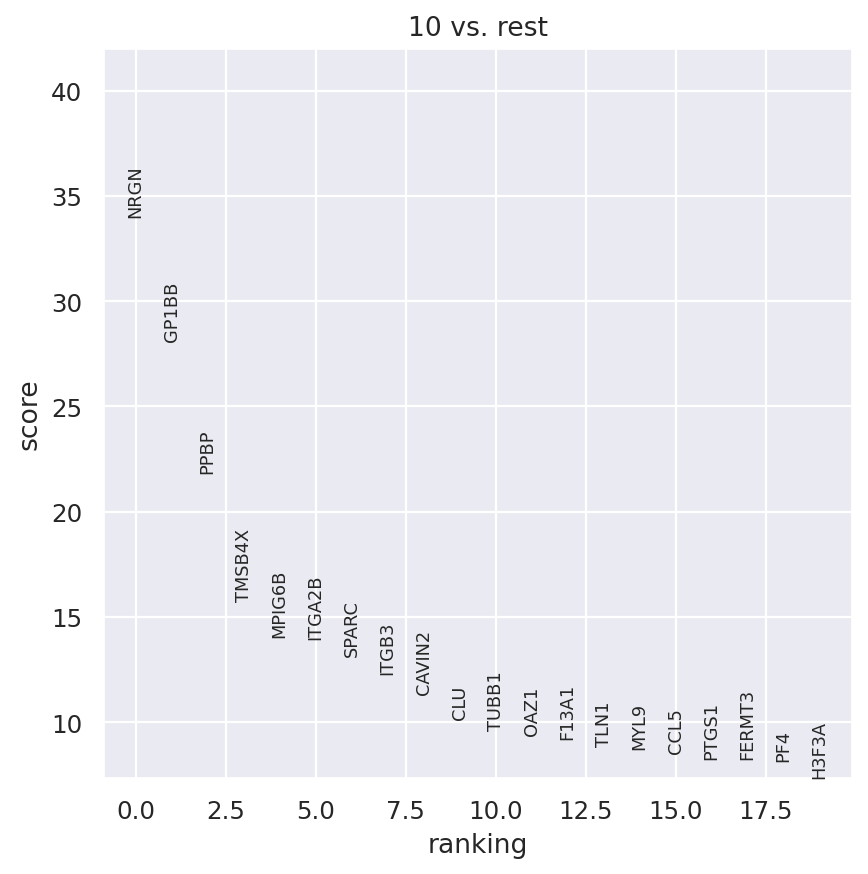

In [79]:
sc.tl.rank_genes_groups(adata_combined, groupby='leiden', groups=['10'], reference='rest')
sc.pl.rank_genes_groups(adata_combined, n_genes=20, sharey=False)


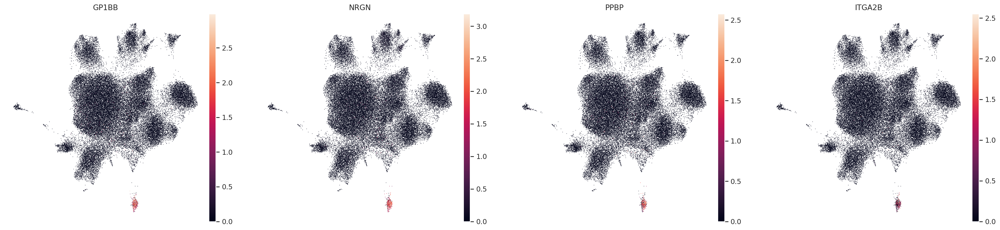

In [80]:
sc.pl.umap(adata_combined, color=['GP1BB', 'NRGN', 'PPBP','ITGA2B'])

In [81]:
#monocytes
cluster_9_cells = adata_combined[adata_combined.obs['leiden'] == '9']

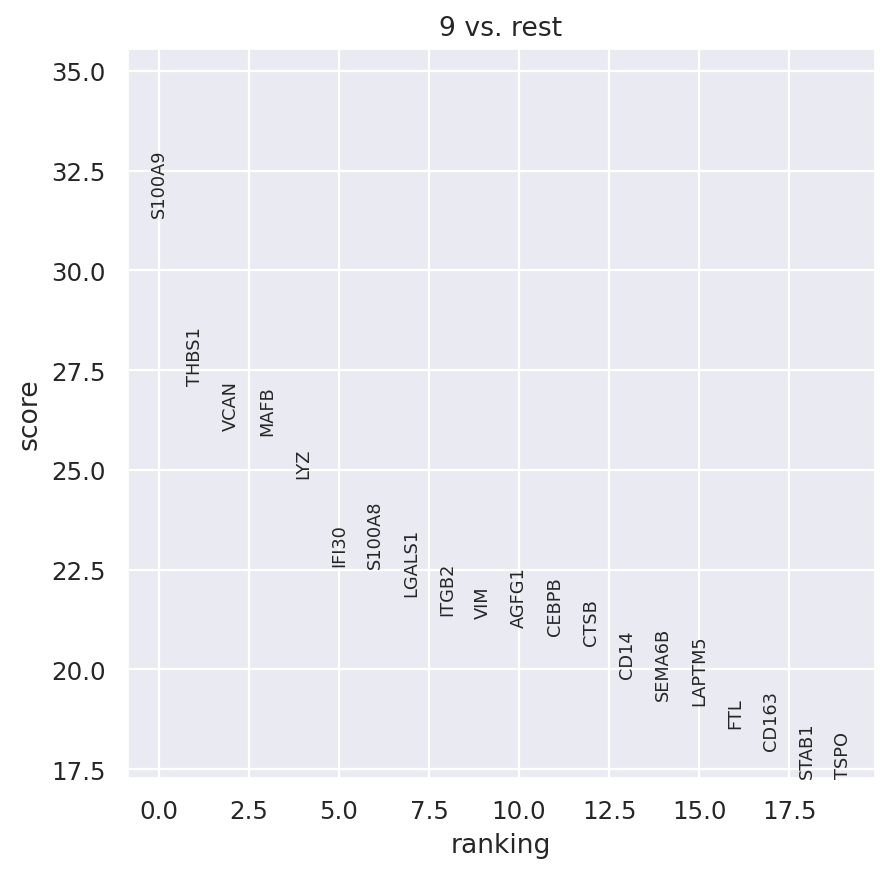

In [82]:
sc.tl.rank_genes_groups(adata_combined, groupby='leiden', groups=['9'], reference='rest')
sc.pl.rank_genes_groups(adata_combined, n_genes=20, sharey=False)
